In [6]:
import os
import random
import sys
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Subset, Dataset
from torchvision.datasets import CIFAR10

from torchvision import transforms, datasets, models
import lpips  # pip install lpips

import cv2
import numpy as np
import math
import matplotlib.pyplot as plt



In [7]:
data_dir = './data'

# Load CIFAR-10 dataset
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Upscale CIFAR-10 for SIFT to work properly
    transforms.ToTensor()
])

train_set = datasets.CIFAR10(root=data_dir, train=True, download=True, transform=transform)
test_set = datasets.CIFAR10(root=data_dir, train=False, download=True, transform=transform)

***************
LPIPS distance

In [8]:
import argparse
import lpips

use_gpu = True

## Initializing the model
loss_fn = lpips.LPIPS(net='alex',version='0.1')

if(use_gpu):
    loss_fn.cuda()
    
def lpips_distance(img1, img2):
    if(use_gpu):
        tensor_img0 = img1.to(torch.device("cuda"))
        tensor_img1 = img2.cuda(torch.device("cuda" ))
    
    tensor_img0 = tensor_img0.unsqueeze(0) * 2 - 1
    tensor_img1 = tensor_img1.unsqueeze(0) * 2 - 1
    
    # Compute distance
    with torch.no_grad():
        dist01 = loss_fn.forward(tensor_img0, tensor_img1)
    
    return dist01.item() 


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /home/msimoni/.local/lib/python3.10/site-packages/lpips/weights/v0.1/alex.pth


***************************
SIFT distance

In [9]:
def tensor_to_cv2(img_tensor):
    # Convert from [0,1] to [0,255] and change to numpy array
    img = img_tensor.permute(1, 2, 0).numpy() * 255
    img = img.astype(np.uint8)
    return img
    
def sift_distance(img1_tensor, img2_tensor):
    # Convert to OpenCV format
    img1 = tensor_to_cv2(img1_tensor)
    img2 = tensor_to_cv2(img2_tensor)

    # Convert to grayscale for SIFT
    gray1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
    gray2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

    # Initialize SIFT detector
    sift = cv2.SIFT_create()

    # Detect keypoints and compute descriptors
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)

    # Ensure descriptors are valid
    if des1 is None or des2 is None:
        #print("No SIFT features detected in one or both images.")
        return math.inf

    # Use brute-force matcher with L2 norm
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)

    # Match descriptors
    matches = bf.match(des1, des2)

    # Ensure matches exist
    if not matches:
        #print("No matches found.")
        return math.inf

    # Compute average distance
    avg_distance = sum(m.distance for m in matches) / len(matches)
    
    return avg_distance

**************************
Classification-based feature distance

In [10]:
import torch
import torchvision.transforms as transforms
from torchvision import datasets
from torchvision import models
from PIL import Image
import numpy as np

# Load a pretrained model
model = models.resnet50(pretrained=True)
avg_pool_layer = model.avgpool    # Average pooling layer
model = torch.nn.Sequential(*list(model.children())[:-1])  # Remove final classification layer
model.eval()

# Image transformation
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

def resnet50_extract_features(tensor):
    img = tensor.unsqueeze(0)
    with torch.no_grad():
            features = model(img).squeeze().numpy()
            features_avg = avg_pool_layer(img).squeeze().numpy()
    return features_avg # / np.linalg.norm(features_avg)

/home/msimoni/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [11]:
# Import math Library
import math 

def euclidean_distance(img1,img2):
    #res = 0
    #for i in range(0, min(len(img1),len(img2))):
    #    res = np.sum(res, np.power(np.subtract(img1[i],img2[i]),2))
    #return np.sqrt(res)

    res = 0
    for i in range(0, min(len(img1), len(img2))):
        res += (img1[i] - img2[i])**2
    return math.sqrt(res)

In [12]:
# L2-Normalization
import numpy as np

def my_L2_norm(features): 
    tmp = 0
    res = [None] * len(features)
    for feature in features:
        tmp = np.add(np.power(feature,2), tmp)
    tmp = np.sqrt(tmp)
        
    for i in range(0,len(features)):
        res[i] = np.divide(features[i], tmp) 
    return res

print(my_L2_norm([6,7,9]))
print(my_L2_norm([10,11,12]))

[np.float64(0.4656903154237997), np.float64(0.543305367994433), np.float64(0.6985354731356995)]
[np.float64(0.5234239225902138), np.float64(0.5757663148492351), np.float64(0.6281087071082565)]


In [13]:
def resnet_distance(img1,img2):
    return euclidean_distance(my_L2_norm(resnet50_extract_features(img1)), my_L2_norm(resnet50_extract_features(img2)))

********************

In [14]:

def get_transformations(image_tensor):
    _, height, width = image_tensor.shape
    transformations = {
        "horizontal_flip": transforms.RandomHorizontalFlip(p=1.0),
        "vertical_flip": transforms.RandomVerticalFlip(p=1.0),
        "rotation": transforms.RandomRotation(degrees=random.randint(30,300)),
        "color_enhancement": transforms.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0.3),
        # Assuming the images are at least 224x224; adjust as necessary.
        "random_crop": transforms.Compose([transforms.RandomCrop((random.randint(height // 3, 3 * height // 4 ), random.randint(width // 3, 3 * width // 4))), transforms.Resize((height,width))]),
        "blur": transforms.GaussianBlur(kernel_size=(7, 25),sigma=(9, 11))
    }
    return transformations



In [15]:
subset = []
original_images = []

# get 100 images random
for i in range(0, 100):
    subset.append(train_set[random.randint(0,len(train_set)-1)][0])

# get 6 images random
for i in range(0, 10):
    img = train_set[random.randint(0,len(train_set)-1)][0]

    original_images.append(img)

    transformations = get_transformations(img)
    for t_name, transform in transformations.items():
        transformed = transform(img)
        subset.append(transformed)

print("size subset: ", len(subset))

size subset:  160


In [16]:
import math
def get_neighbours(image, num_neigh):
    lpips_neigh = [(None,math.inf)]*num_neigh
    sift_neigh = [(None,math.inf)]*num_neigh
    
    for testing_img in subset:
        tmp_dist = lpips_distance(image,testing_img)
        i = 0
        while(i < num_neigh and tmp_dist < lpips_neigh[i][1]):
            if(i != 0):
                lpips_neigh[i-1] = lpips_neigh[i]
            i += 1
        if i != 0:
            lpips_neigh[i-1] = (testing_img,tmp_dist)
            
        
        tmp_dist = sift_distance(image,testing_img)
        i = 0
        while(i < num_neigh and tmp_dist < sift_neigh[i][1]):
            if(i != 0):
                sift_neigh[i-1] = sift_neigh[i]
            i += 1
        if i != 0:
            sift_neigh[i-1] = (testing_img,tmp_dist)

    return (lpips_neigh, sift_neigh)

In [17]:
def show_plot(orig_img, neighbours, num_neigh, num_plot, dist_type):
    fig = plt.figure(num_plot)
    fig.set_size_inches(12, 12)

    # Convert orig_img if it's a tensor
    if isinstance(orig_img, torch.Tensor):
        orig_img = orig_img.permute(1, 2, 0).numpy()

    fig.add_subplot(5, 5, 1)
    plt.imshow(orig_img)
    plt.title(dist_type)
    plt.xticks([]) 
    plt.yticks([])

    for i, (img, dist) in enumerate(neighbours):
        if img is None:
            img = orig_img
        else:
            # Convert image if it's a tensor
            if isinstance(img, torch.Tensor):
                img = img.permute(1, 2, 0).numpy()

        fig.add_subplot(5, 5, i + 6)
        plt.imshow(img)
        plt.title("%.3f" % dist)
        plt.xticks([])
        plt.yticks([])

    plt.show()

In [18]:
def get_random_neigh(image, num_neigh):
    subset = []

    # get 100 images random
    for i in range(0, 200):
        subset.append(train_set[random.randint(0,len(train_set)-1)][0])
        
    test_neigh = [(None,math.inf)]*num_neigh
    
    for testing_img in subset:
        tmp_dist = lpips_distance(image,testing_img)
        i = 0
        while(i < num_neigh and tmp_dist < test_neigh[i][1]):
            if(i != 0):
                test_neigh[i-1] = test_neigh[i]
            i += 1
        if i != 0:
            test_neigh[i-1] = (testing_img,tmp_dist)
    return test_neigh

In [ ]:
for i, (img,_) in enumerate(train_set):
    if i >= 20:
        break
    num_neigh = 20
    neigh = get_random_neigh(img, num_neigh)
    show_plot(img, neigh , num_neigh, i, "lpips distance neighbours")

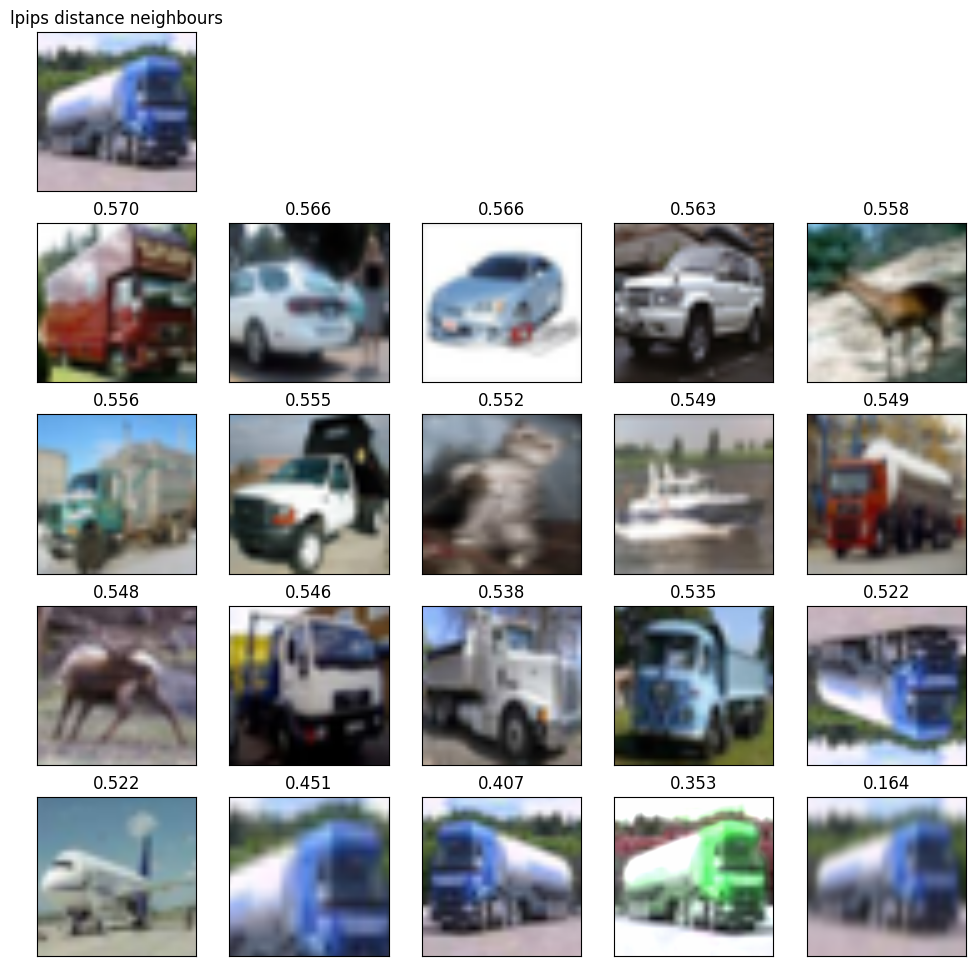

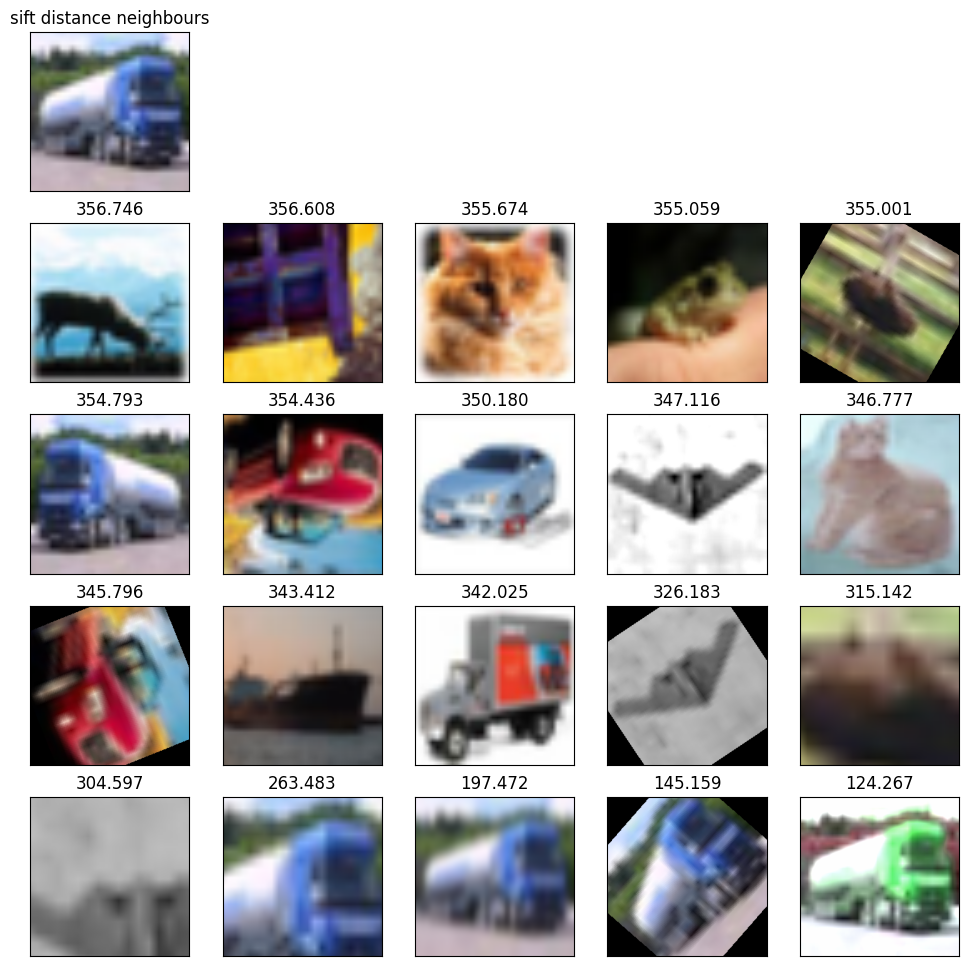

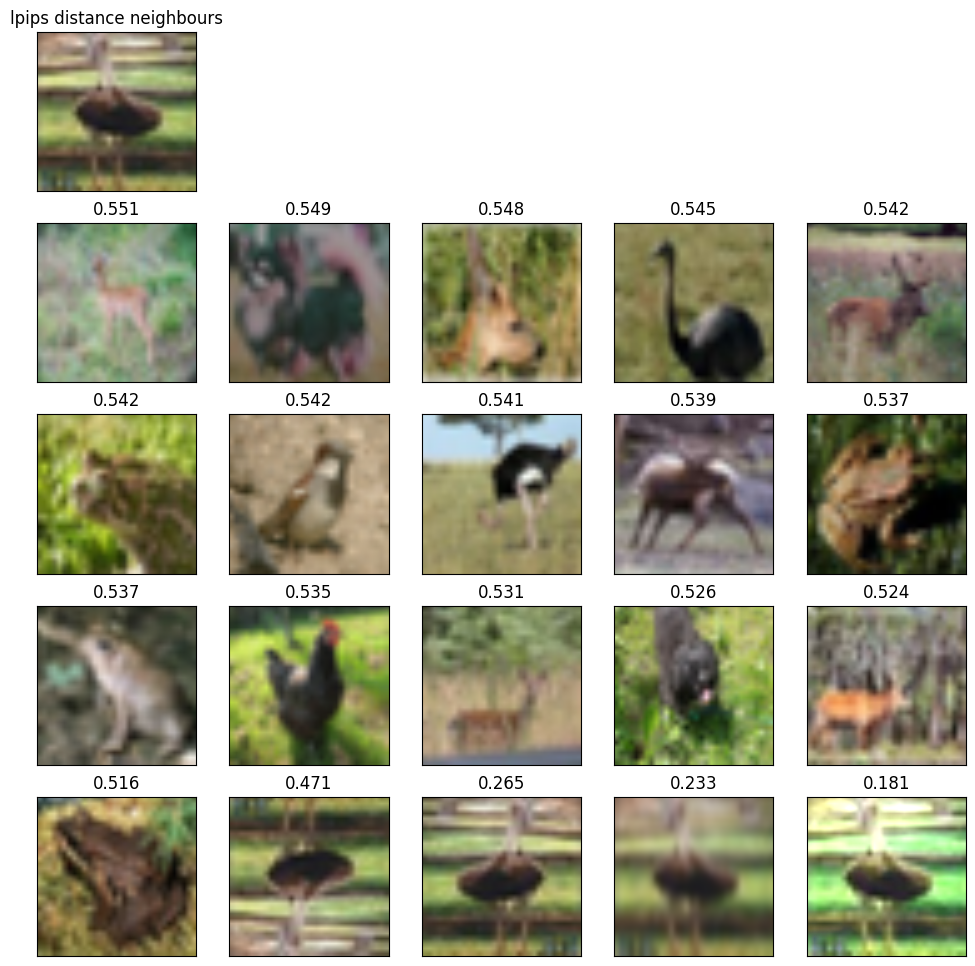

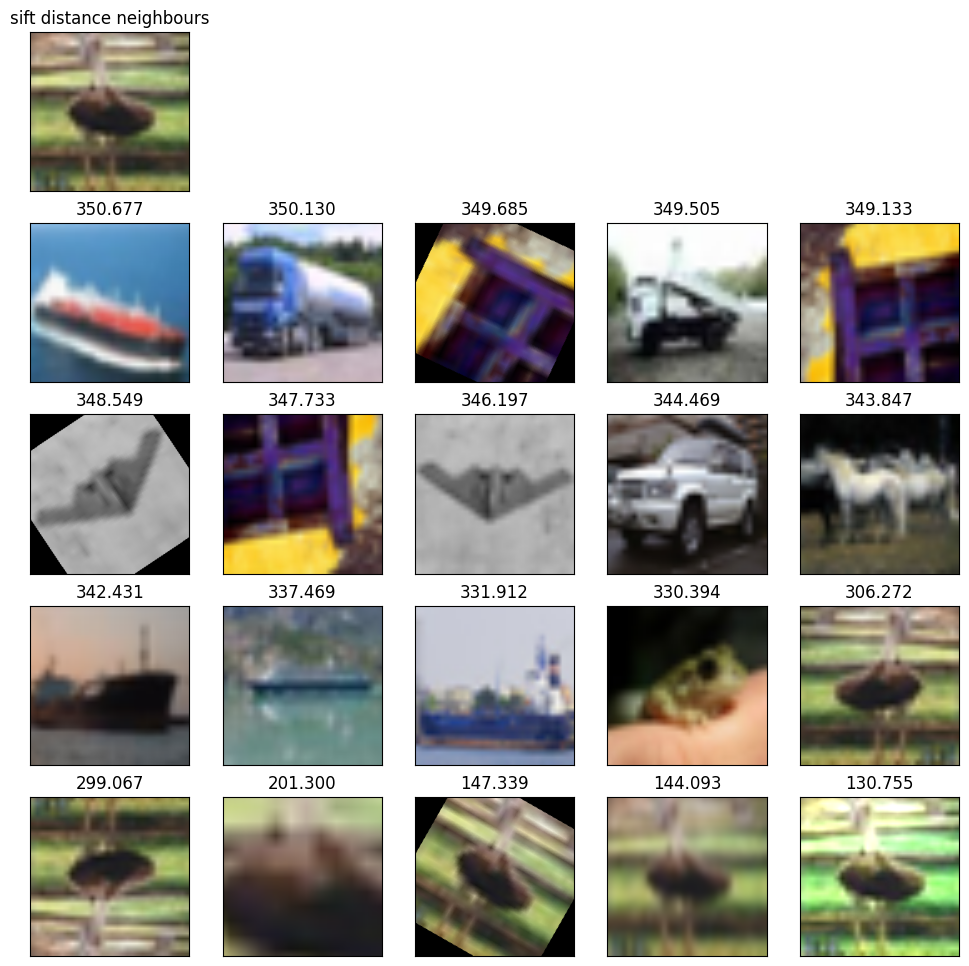

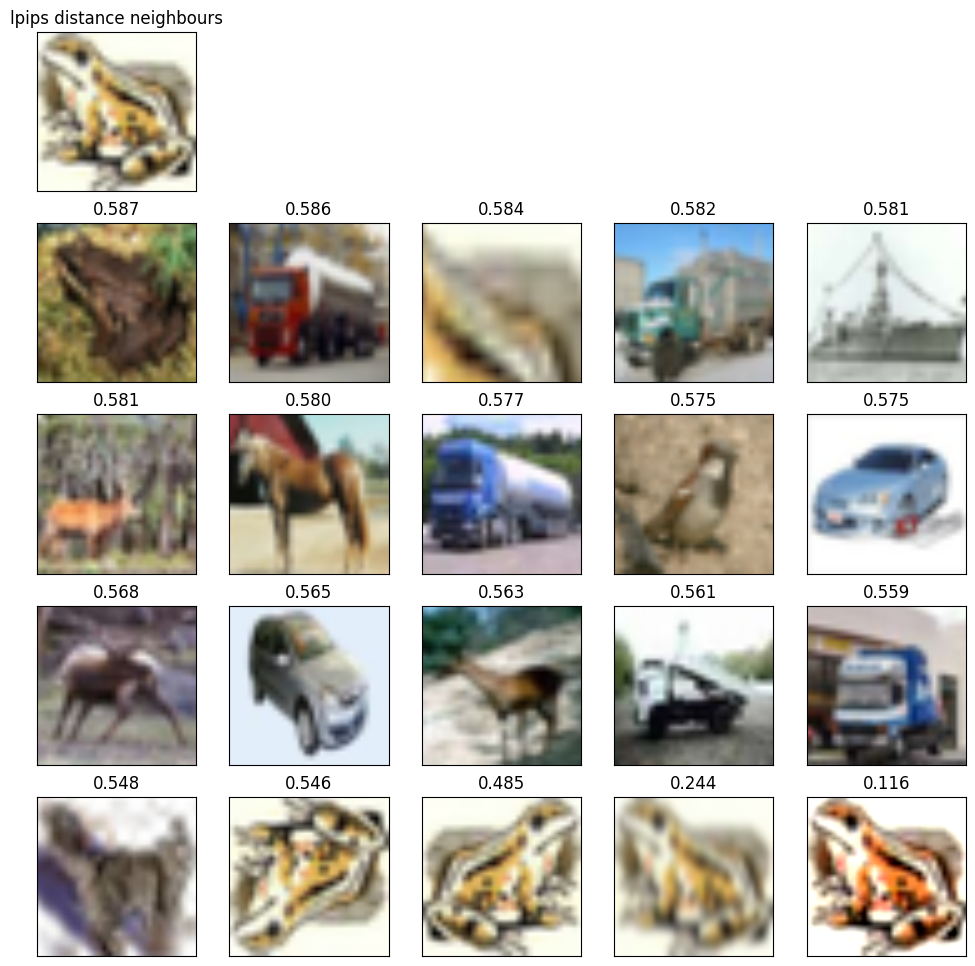

...

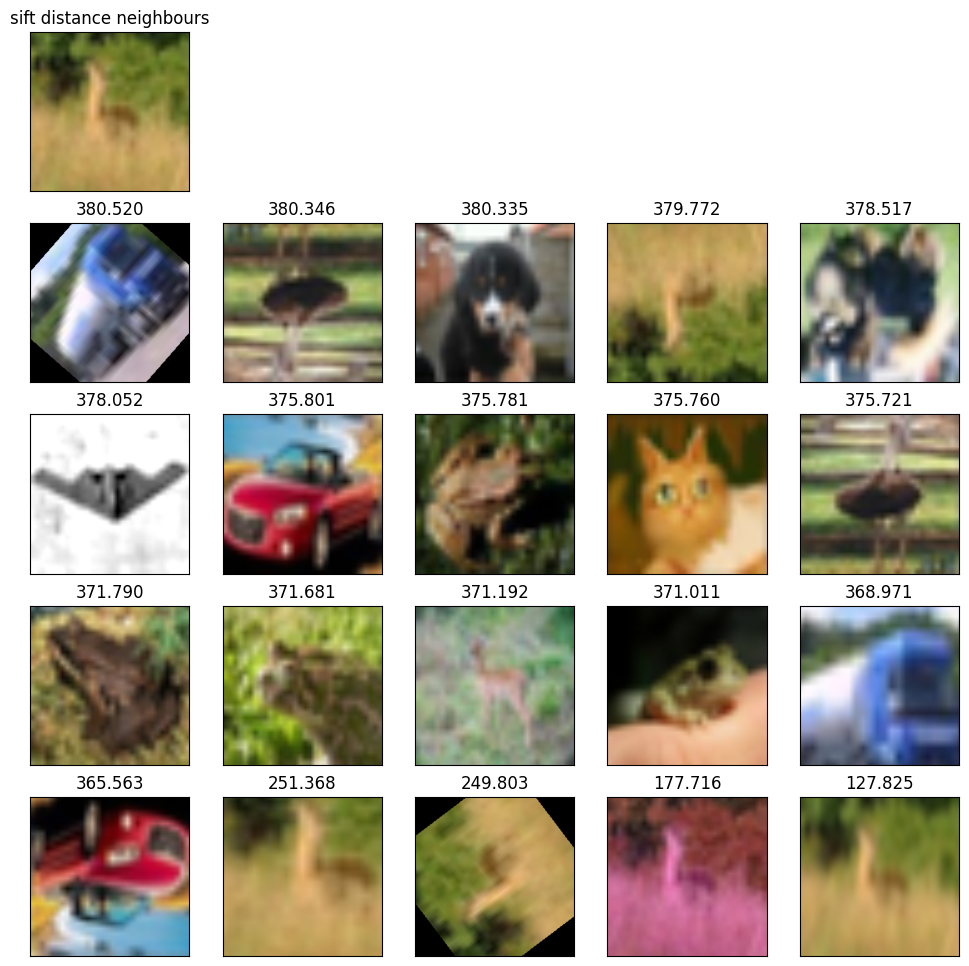

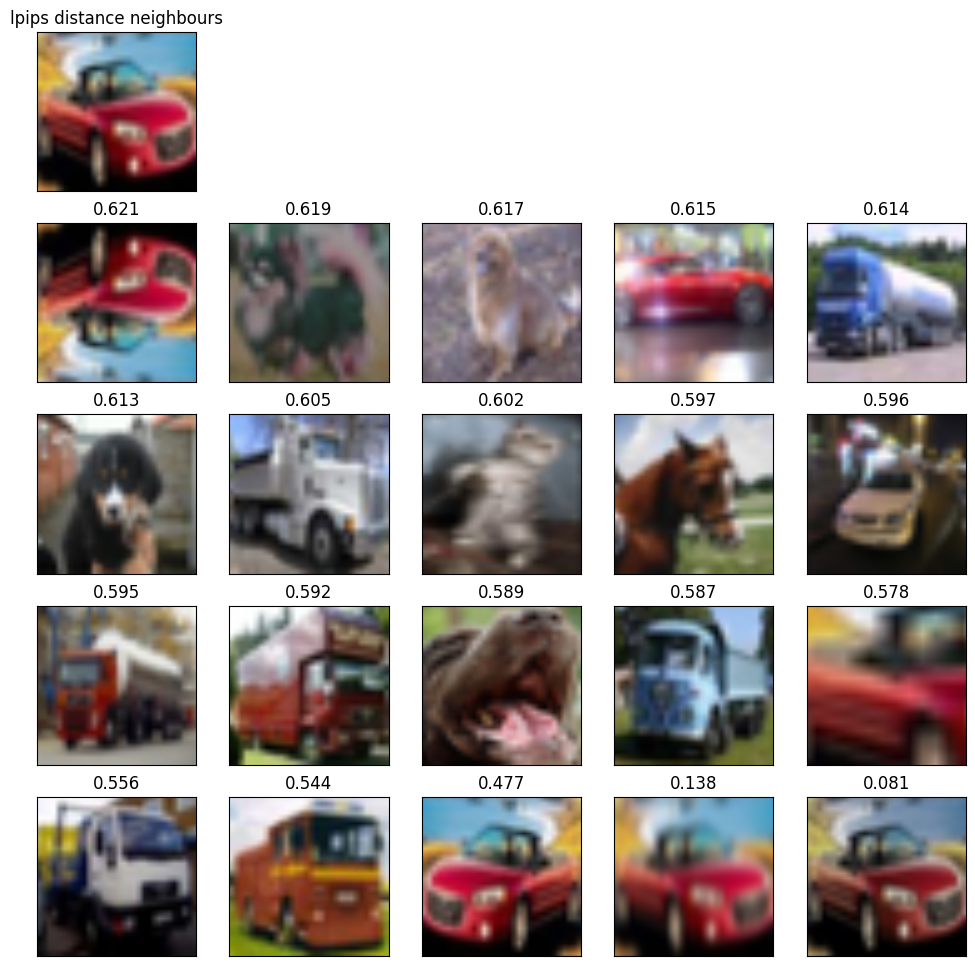

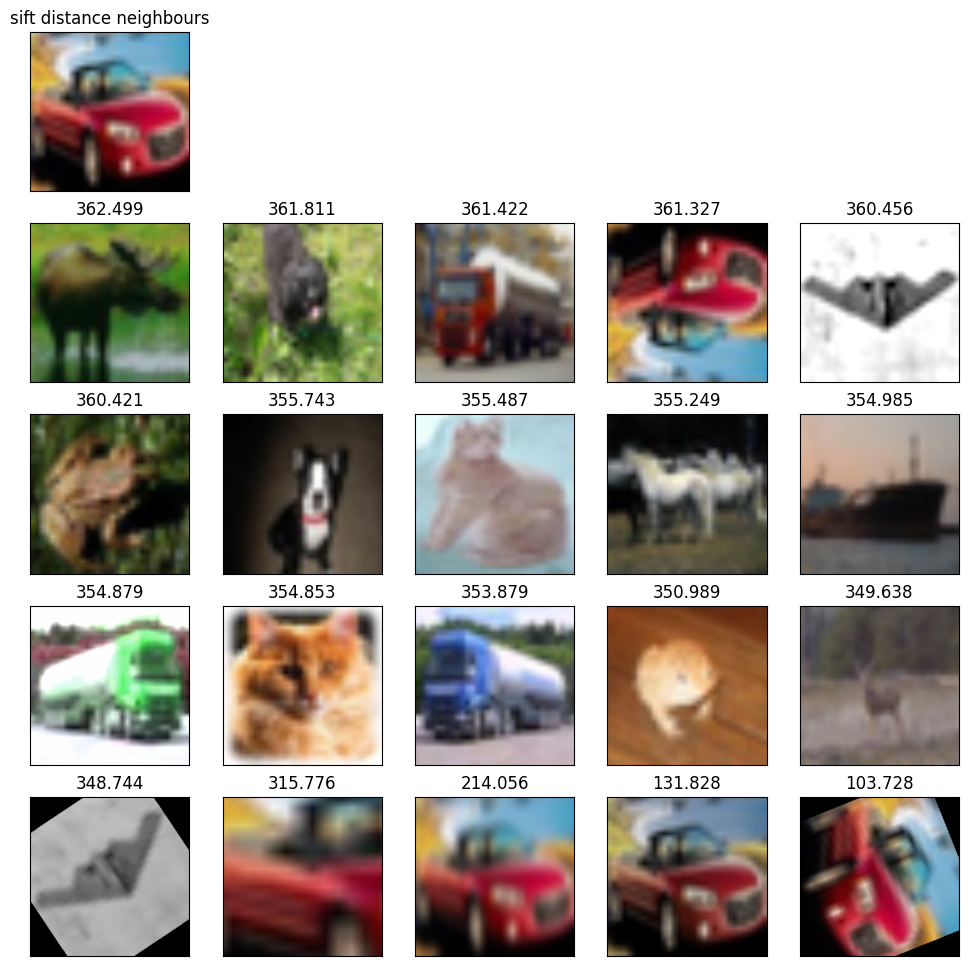

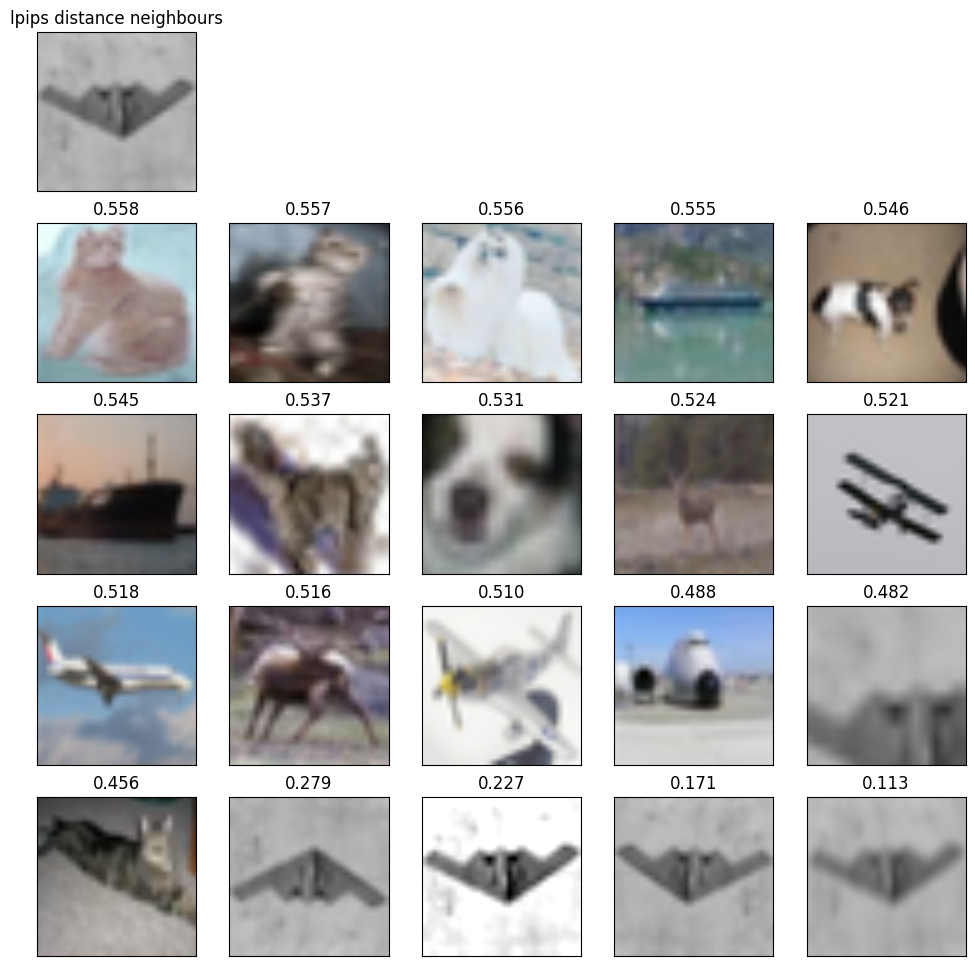

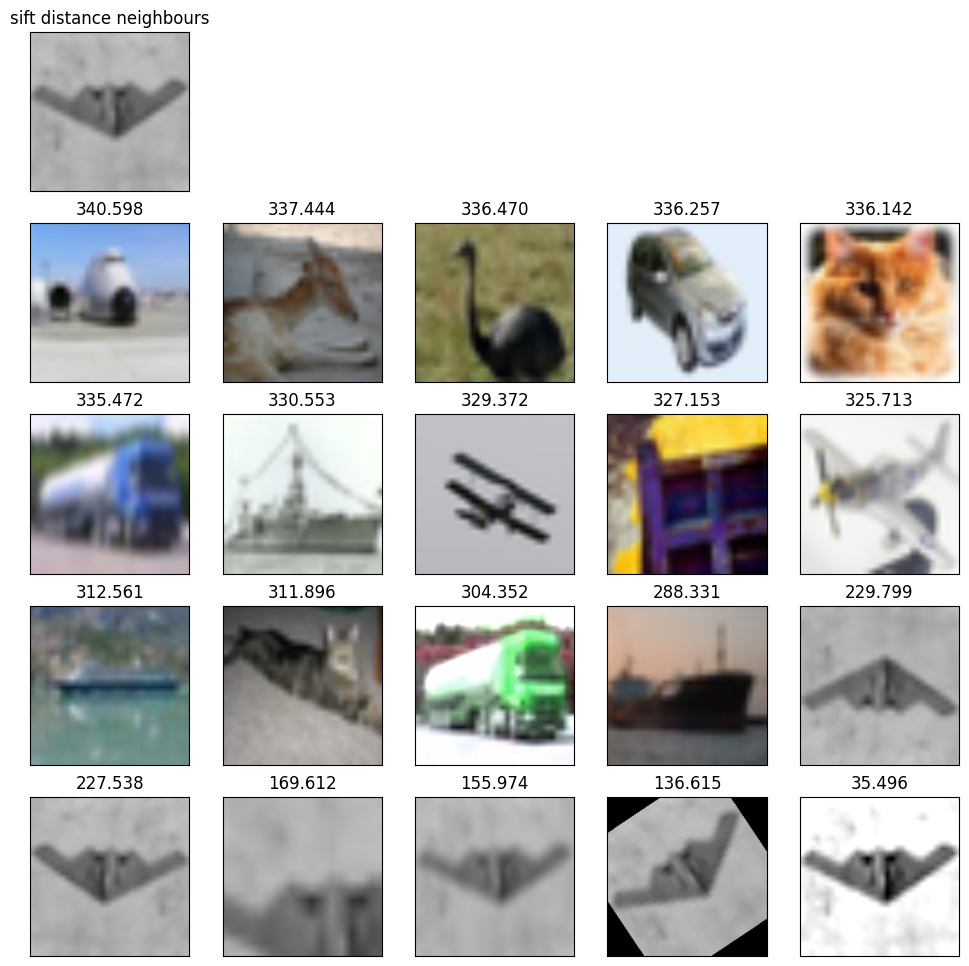

In [19]:
num_neigh = 20

# comparison lpips and sift
for i,orig_img in enumerate(original_images):
    lpips_neigh,sift_neigh = get_neighbours(orig_img, num_neigh)
    show_plot(orig_img, lpips_neigh, num_neigh, i*2, "lpips distance neighbours")
    show_plot(orig_img, sift_neigh, num_neigh, i*2+1, "sift distance neighbours")
    

In [20]:
def show_plot_3(orig_img, neighbours, num_neigh, num_plot, dist_type):
    fig = plt.figure(num_plot)
    fig.set_size_inches(20, 10)

    # Convert orig_img if it's a tensor
    if isinstance(orig_img, torch.Tensor):
        orig_img = orig_img.permute(1, 2, 0).numpy()

    fig.add_subplot(5, 10, 1)
    plt.imshow(orig_img)
    plt.title(dist_type)
    plt.xticks([]) 
    plt.yticks([])

    for i, (img, dist) in enumerate(neighbours):
        if img is None:
            img = orig_img
        else:
            # Convert image if it's a tensor
            if isinstance(img, torch.Tensor):
                img = img.permute(1, 2, 0).numpy()

        fig.add_subplot(5, 10, i + 11)
        plt.imshow(img)
        plt.title("%.3f" % dist)
        plt.xticks([])
        plt.yticks([])

    plt.show()

In [21]:
def get_neighbours_3(image, num_neigh):
    lpips_neigh = [(None,math.inf)]*num_neigh
    sift_neigh = [(None,math.inf)]*num_neigh
    res_neigh = [(None,math.inf)]*num_neigh
    
    for testing_img in subset:
        tmp_dist = lpips_distance(image,testing_img)
        i = 0
        while(i < num_neigh and tmp_dist < lpips_neigh[i][1]):
            if(i != 0):
                lpips_neigh[i-1] = lpips_neigh[i]
            i += 1
        if i != 0:
            lpips_neigh[i-1] = (testing_img,tmp_dist)
            
        
        tmp_dist = sift_distance(image,testing_img)
        i = 0
        while(i < num_neigh and tmp_dist < sift_neigh[i][1]):
            if(i != 0):
                sift_neigh[i-1] = sift_neigh[i]
            i += 1
        if i != 0:
            sift_neigh[i-1] = (testing_img,tmp_dist)

        tmp_dist = resnet_distance(image,testing_img)
        i = 0
        while(i < num_neigh and tmp_dist < res_neigh[i][1]):
            if(i != 0):
                res_neigh[i-1] = res_neigh[i]
            i += 1
        if i != 0:
            res_neigh[i-1] = (testing_img,tmp_dist)

    return (lpips_neigh, sift_neigh, res_neigh)

lpips distance neighbours


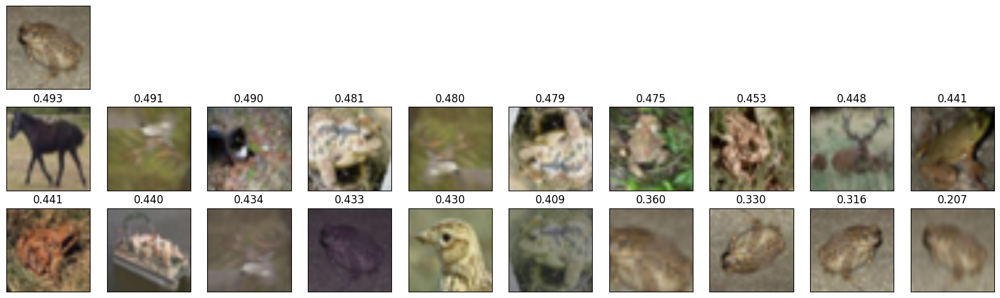


sift distance neighbours


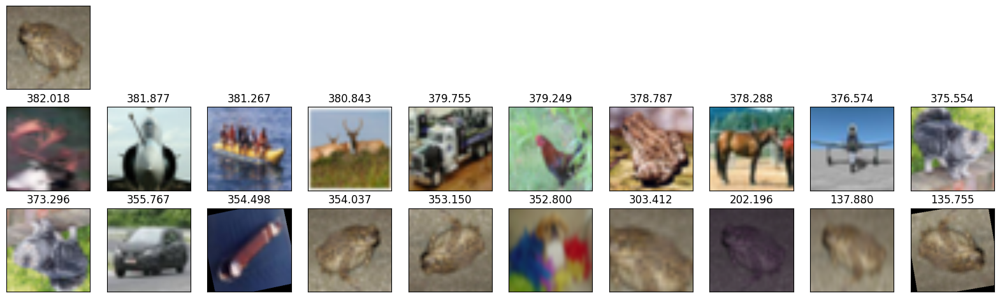


features distance neighbours


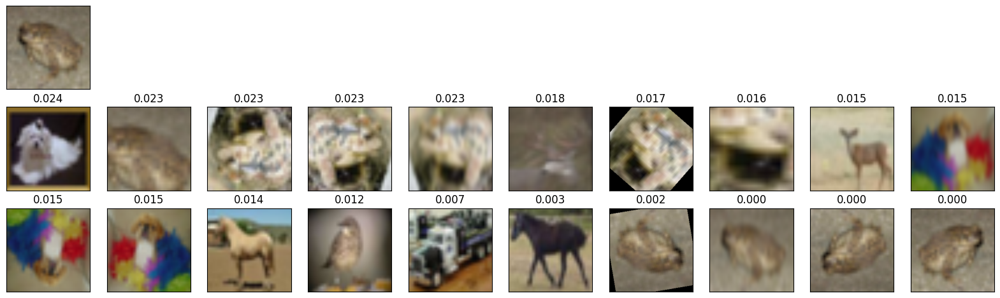

lpips distance neighbours


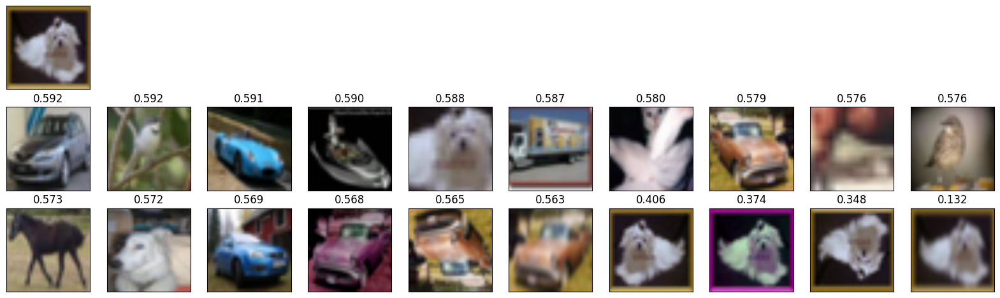


sift distance neighbours


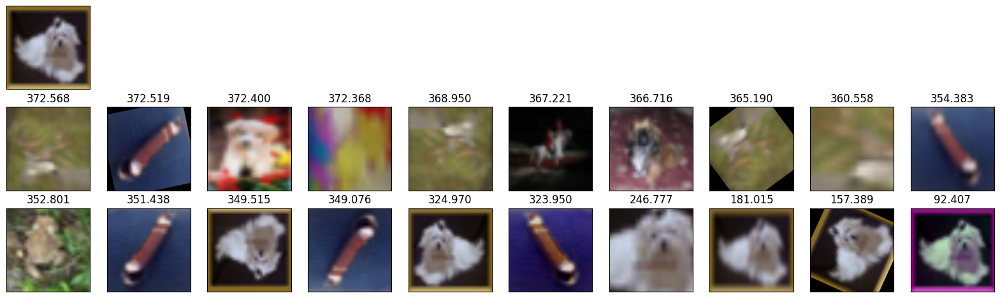


features distance neighbours


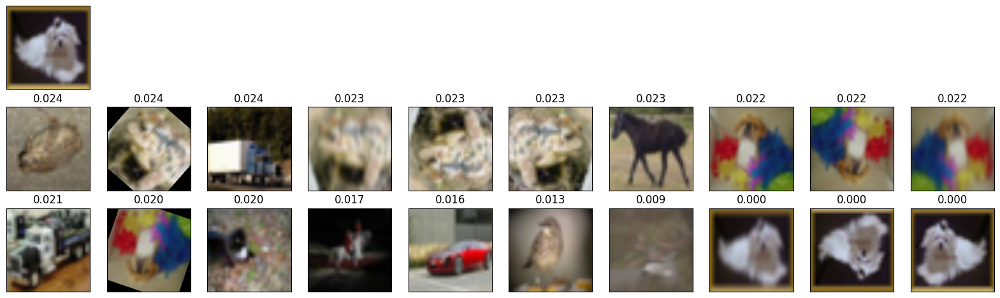

lpips distance neighbours


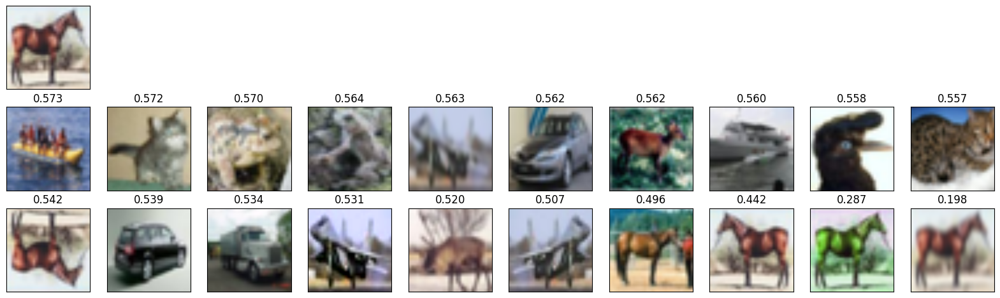


sift distance neighbours


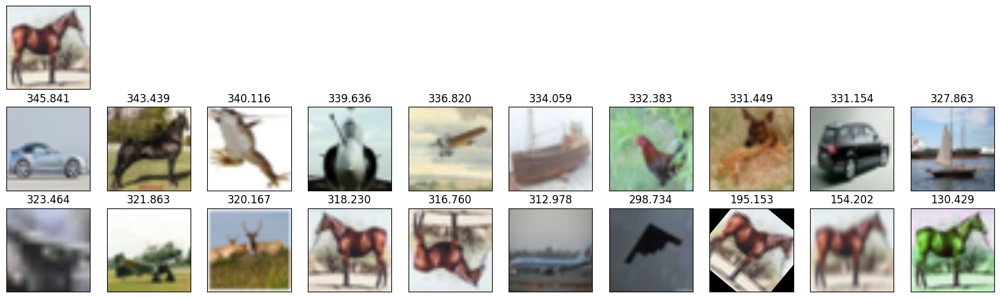


features distance neighbours


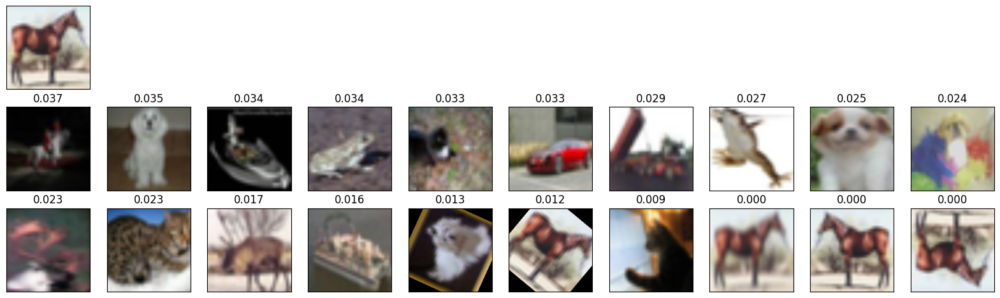

lpips distance neighbours


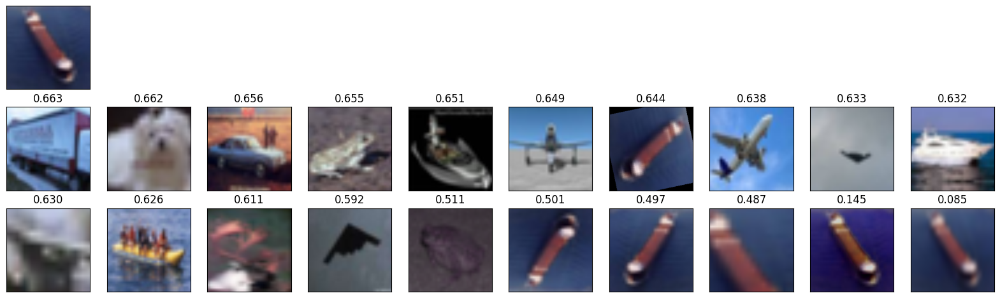


sift distance neighbours


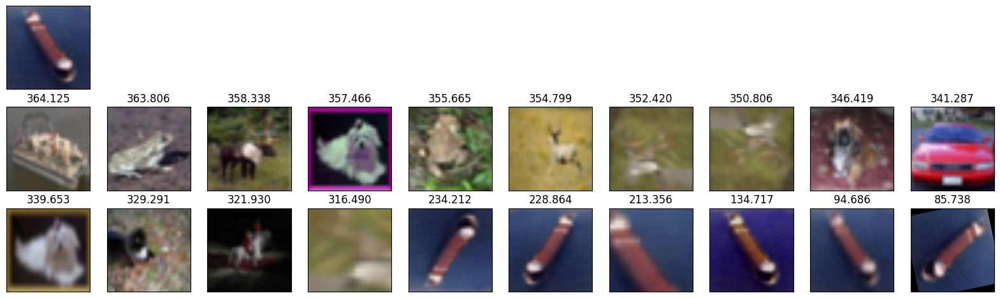


features distance neighbours


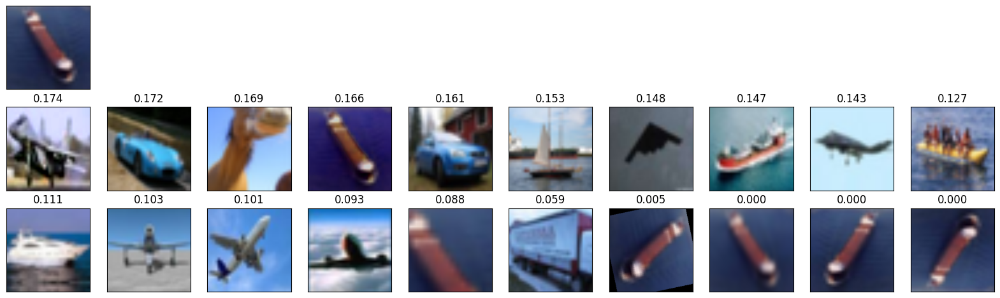

lpips distance neighbours


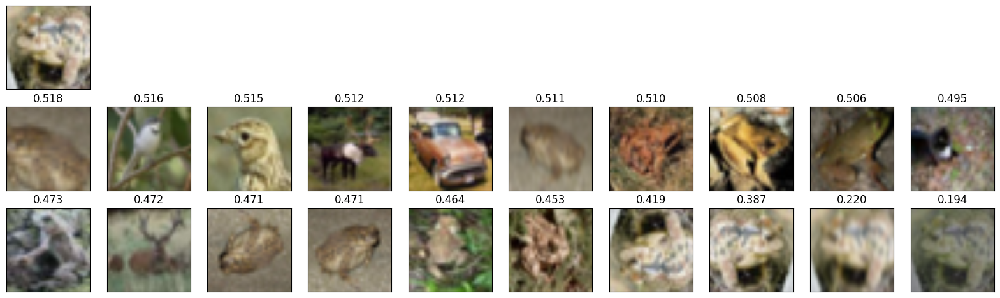


sift distance neighbours


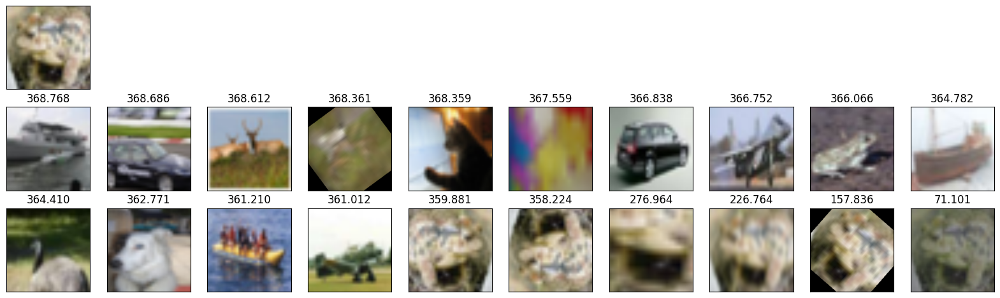


features distance neighbours


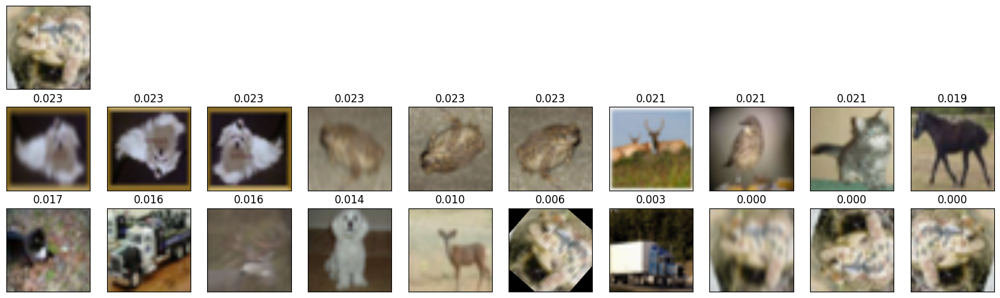

lpips distance neighbours


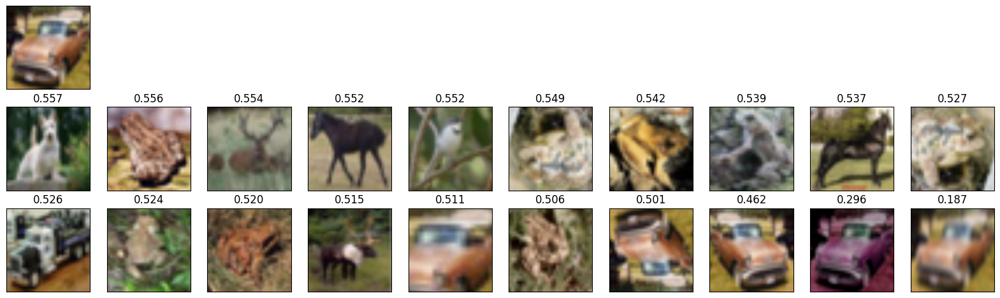


sift distance neighbours


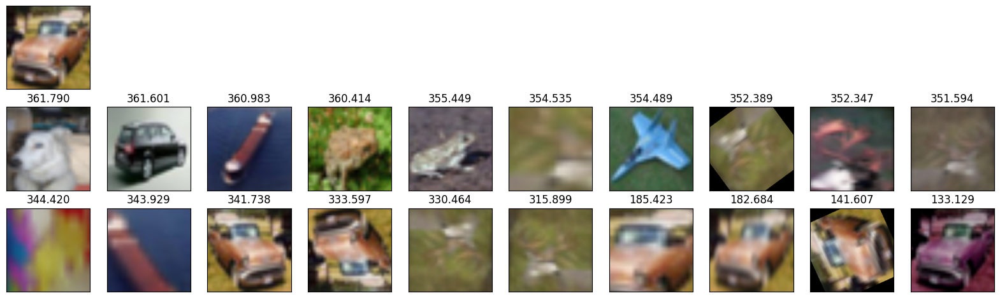


features distance neighbours


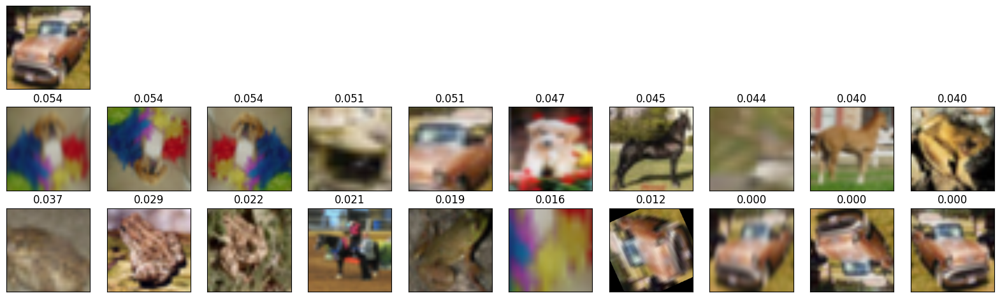

lpips distance neighbours


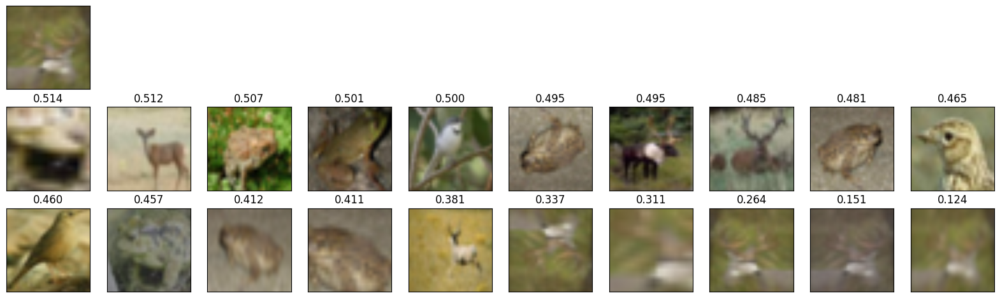


sift distance neighbours


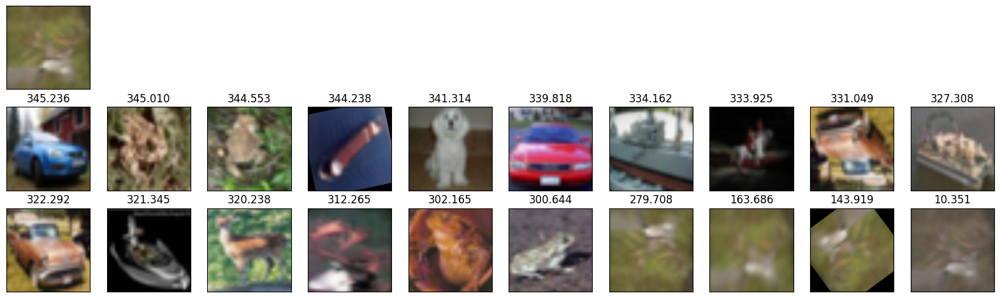


features distance neighbours


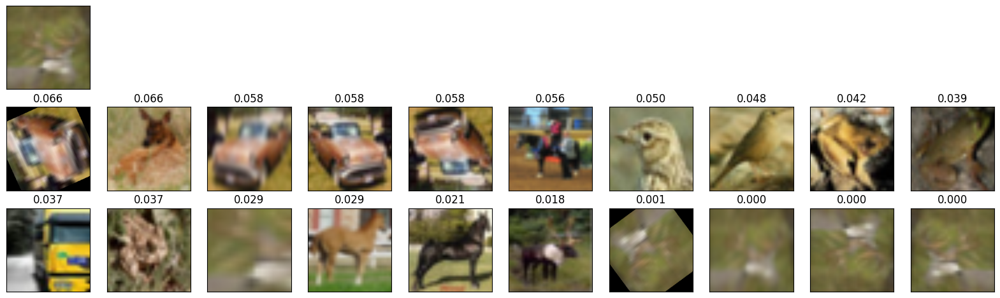

lpips distance neighbours


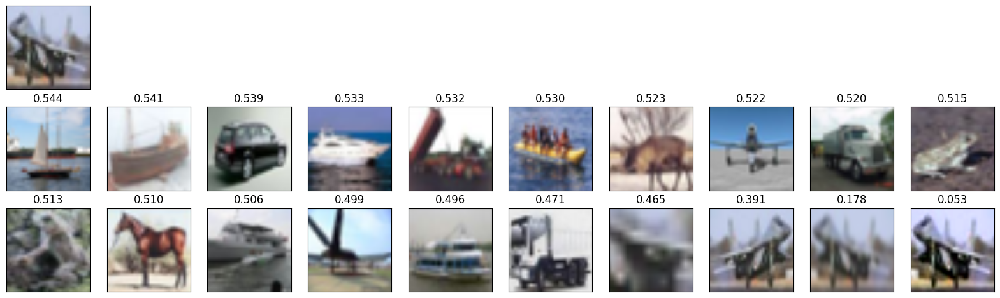


sift distance neighbours


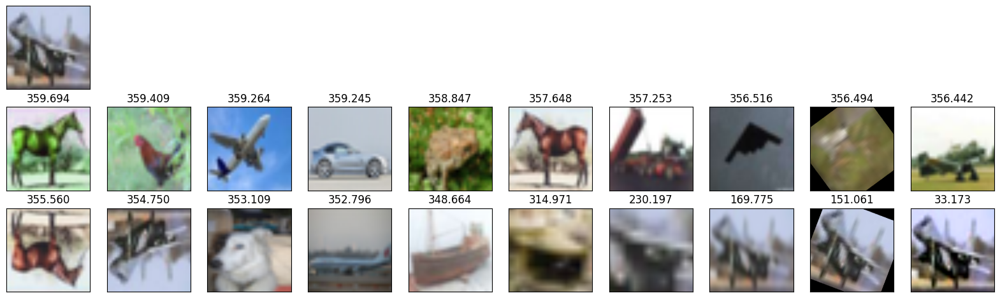


features distance neighbours


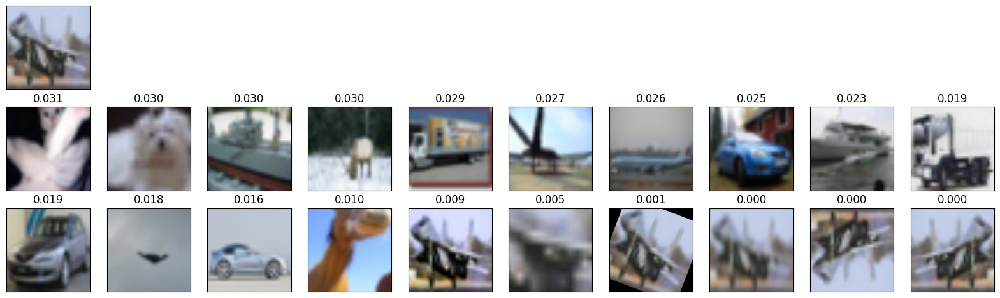

lpips distance neighbours


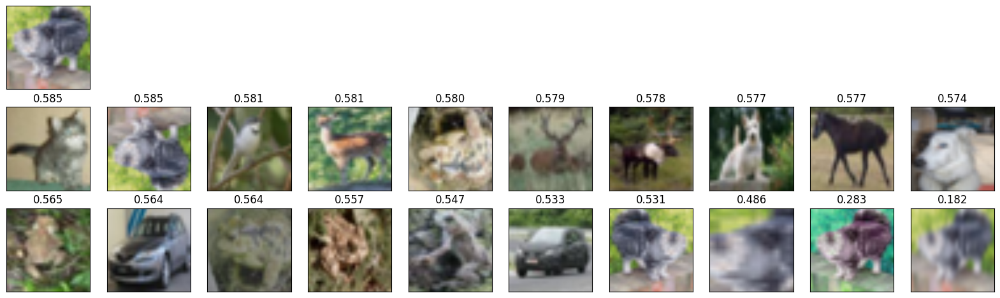


sift distance neighbours


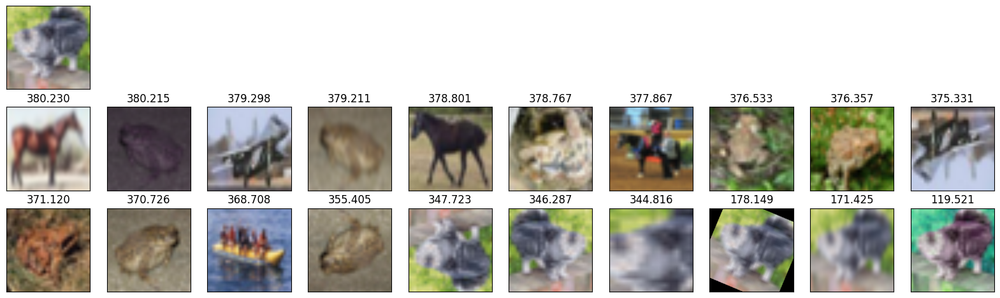


features distance neighbours


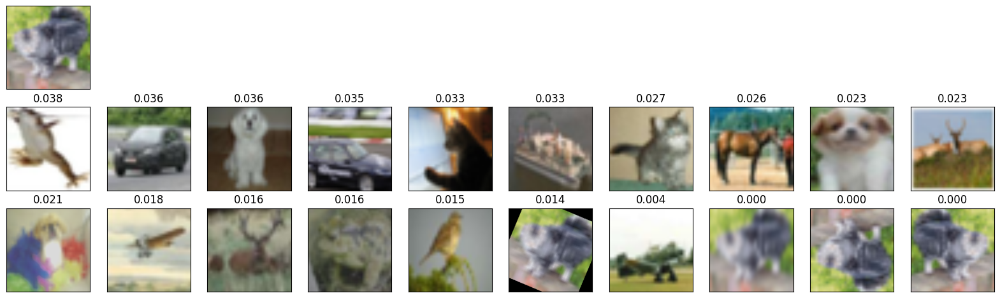

lpips distance neighbours


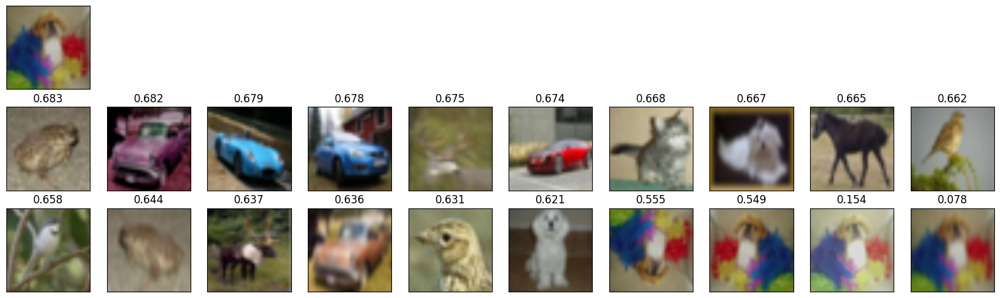


sift distance neighbours


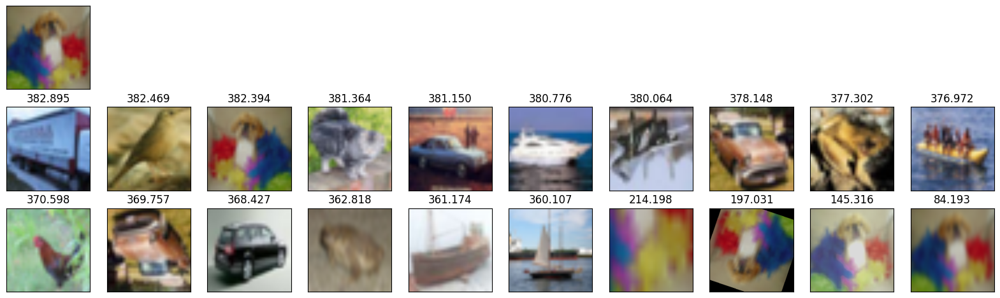


features distance neighbours


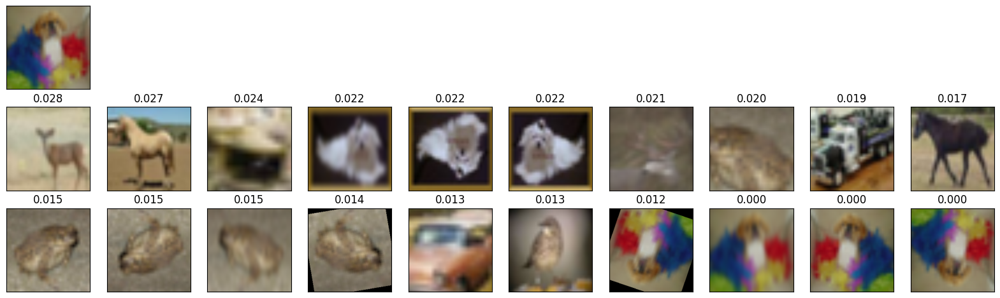

In [26]:
num_neigh = 20

#comparison lpips, sift and feature rapresentation of resnet
for i,orig_img in enumerate(original_images):
    lpips_neigh,sift_neigh,res_neigh = get_neighbours_3(orig_img, num_neigh)
    print("lpips distance neighbours")
    show_plot_3(orig_img, lpips_neigh, num_neigh, i*3, "")
    print("\nsift distance neighbours")
    show_plot_3(orig_img, sift_neigh, num_neigh, i*3+1, "")
    print("\nfeatures distance neighbours")
    show_plot_3(orig_img, res_neigh, num_neigh, i*3+2, "")